In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [3]:
import matplotlib.pyplot as plt
import torch
import numpy as np
from torch.autograd import grad


import numpy as np
import matplotlib.pyplot as plt
import torch

import torch
from functorch import vmap


import matplotlib.pyplot as plt
import numpy as np


import numpy as np
import torch
import ot as pot

import matplotlib.pyplot as plt
from matplotlib.ticker import NullLocator
from matplotlib.patches import Rectangle

import matplotlib
import pandas as pd
matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'


from src.models.components.mmd import linear_mmd2, mix_rbf_mmd2, poly_mmd2
from src.models.components.optimal_transport import wasserstein


In [4]:
import os
# read all files in folder
 
def read_all_files(folder, concat=True):
    samples = []
    files = os.listdir(folder)
    files = [f for f in files if f.endswith(".pt") or f.endswith(".npz") and not f.startswith(".")]
    files = [os.path.join(folder, f) for f in files]
    for f in files:
        if f.endswith(".pt"):
            samples.append(torch.load(f))
        if f.endswith(".npz"):
            samples.append(torch.tensor(np.load(f, allow_pickle=True)["samples"]))
    if concat:
        return torch.cat(samples, dim=0)
    else:
        return torch.stack(samples)

# sample randomly from torch array 
def sample_from_tensor(tensor, n_samples):
    idx = torch.randperm(tensor.shape[0])[:n_samples]
    return tensor[idx].cpu()

In [219]:
# Table processing
def process_line(means, highlight, highlight_index, highlight_max, ignore_std):
    if highlight:
        if highlight_max:
            tops = set(means.groupby(highlight_index).idxmax())
        else:
            tops = set(means.groupby(highlight_index).idxmin())
    else:
        tops = set()

    def process_line(x):
        if ignore_std:
            if x.name in tops:
                return rf"\textbf{{{x['mean']:0.3f}}}"
            return rf"{x['mean']:0.3f}"
        if x.name in tops:
            return rf"\textbf{{{x['mean']:0.3f} $\pm$ {x['std']:0.3f}}}"
        return rf"{x['mean']:0.3f} $\pm$ {x['std']:0.3f}"

    return process_line


def mean_pm_std(
    data,
    index,
    columns,
    value,
    highlight=True,
    highlight_cols=True,
    highlight_max=True,
    ignore_std=False,
):
    assert len(data) > 0
    groupby = data.groupby([*index, *columns])
    means = groupby.mean()[value].rename("mean")
    stds = groupby.std()[value].rename("std")
    ddf = pd.concat([means, stds], axis=1).T
    highlight_index = columns if highlight_cols else index
    ddf = ddf.apply(
        process_line(means, highlight, highlight_index, highlight_max, ignore_std)
    )
    ddf = ddf.reset_index().pivot(index=index, columns=columns)
    ddf.columns = ddf.columns.droplevel(level=0)
    return ddf

In [220]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [221]:
colors = {}
colors["FAB"] = "#4daf4a"
colors["iDEM"] = "#377eb8" 
colors["pDEM"] = "#984ea3"
colors["Test"] = "#ff7f00"
colors["PIS"] = "#a65628"
colors["DDS"] = "#e41a1c"

labels = {}
labels["FAB"] = "FAB"
labels["iDEM"] = "iDEM (ours)"
labels["pDEM"] = "pDEM (ours)"
labels["Test"] = "Ground Truth"
labels["PIS"] = "PIS"
labels["DDS"] = "DDS"

## Metrics

In [200]:
# create dictionary
samples = {}
energies = {}
dists = {}
data_df = {}

In [377]:
data = "lj13"
filter = False
num_samples = 5000

if data == "lj13":
    dimensionality = 39
    n_particles = 13
    n_spatial_dim = 3
    from src.energies.lennardjones_energy import LennardJonesEnergy
    target = LennardJonesEnergy(
        dimensionality=dimensionality,
        n_particles=13,
        device=device,
        data_path = "../../data/test_split_LJ13-1000.npy",
        data_path_train =  "../../data/train_split_LJ13-1000.npy",
        data_path_val = "../../data/test_split_LJ13-1000.npy",
    )

if data == "dw4":
    dimensionality = 8
    n_particles = 4
    n_spatial_dim =2 
    from src.energies.multi_double_well_energy import MultiDoubleWellEnergy
    target = MultiDoubleWellEnergy(dimensionality,
                                   n_particles=4,
                                   data_path="../../data/test_split_DW4.npy",
                                   data_path_train="../../data/train_split_DW4.npy", 
                                   data_path_val="../../data/val_split_DW4.npy", 
                                   device=device)
    
if data == "lj55":
    n_particles = 55
    n_spatial_dim = 3
    dimensionality = 165
    from src.energies.lennardjones_energy import LennardJonesEnergy
    target = LennardJonesEnergy(
        dimensionality=dimensionality,
        n_particles=55,
        device=device,
        data_path = "../../data/test_split_LJ55-1000-part1.npy",
        data_path_train= "../../data/train_split_LJ55-1000-part1.npy",
        data_path_val = "../../data/val_split_LJ55-1000-part1.npy",
    )

if data == "gmm":
    from src.energies.gmm_energy import GMM
    dimensionality = 2
    target = GMM(dimensionality=dimensionality,
                n_mixes=40,
                loc_scaling= 40,
                log_var_scaling=1.0,
                device="device")

In [378]:
file_names = {}

if data == "gmm":
    file_names["FAB"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/fab_gmm_samples/"
    file_names["DDS"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/dds_samples/" + data + '/'
else:
    file_names["FAB"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/fab_samples/" + data + '/'
    file_names["DDS"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/dds_samples_egnn/" + data + '/'

file_names["PIS"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/pis_samples/" + data + '/'
file_names["pDEM"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/dem_samples/" + data + '/'
file_names["iDEM"] = "/network/scratch/a/alexander.tong/se3_diffusion/dem/idem_samples/" + data + '/'



for key in file_names.keys():
    s = read_all_files(file_names[key], concat=False).to(device)
    samples[key] = torch.vmap(sample_from_tensor, in_dims=(0, None), randomness="different")(s, num_samples).reshape(-1, num_samples, dimensionality)
    if key == "iDEM" or key == "pDEM":
        samples[key] = torch.vmap(target.unnormalize)(samples[key])

test_samples = target.unnormalize(target.sample_train_set(num_samples)).to(device)
samples["Test"] = test_samples.unsqueeze(0)

In [379]:
if data == "gmm":
    samples["FAB"] = samples["FAB"].clip_(-200, 200)
    
for key in samples.keys():
    energies[key] = torch.vmap(target)(samples[key]).detach().cpu().numpy()

if data != "gmm":
    for key in samples.keys():
        dists[key] = torch.vmap(target.interatomic_dist)(samples[key]).detach().view(len(samples[key]), -1).cpu().numpy()
else:
    for key in samples.keys():
        dists[key] = [None] * 10

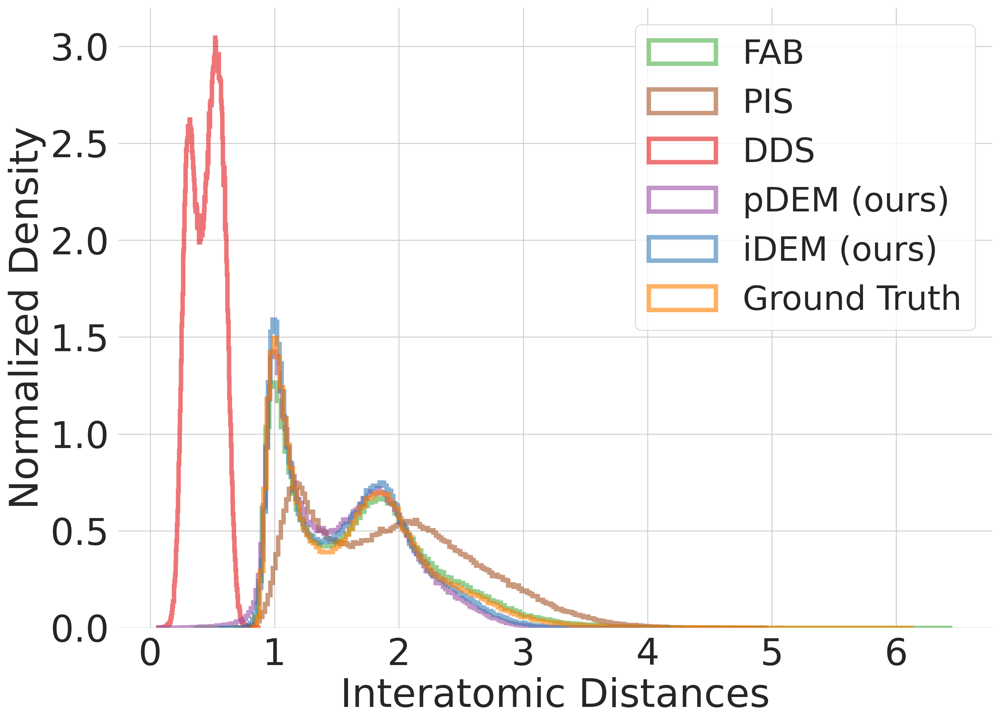

/home/mila/t/tara.akhoundsadegh/.conda/envs/actinfenv/lib/python3.10/site-packages/numpy/lib/histograms.py:885: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


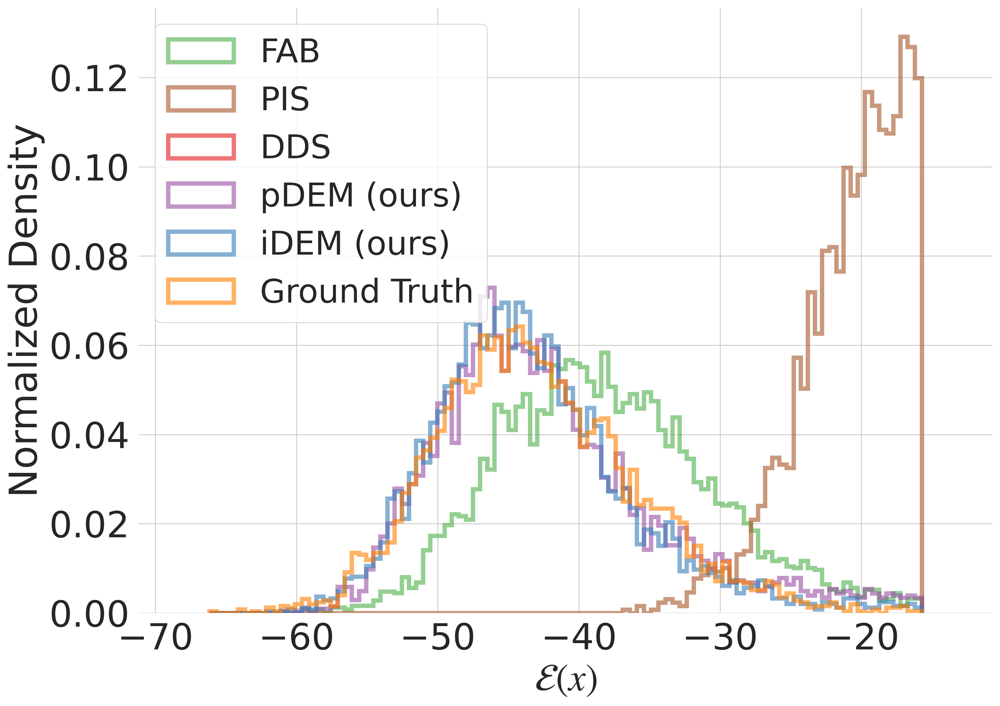

In [380]:
if data != "gmm":

    fig, ax = plt.subplots(figsize = (14,10),dpi=300)
    fig.patch.set_facecolor('white')

    for key in ["FAB", "PIS", "DDS", "pDEM", "iDEM", "Test"]:
        plt.hist(
            dists[key][0],
            bins=200,
            density=True,
            histtype="step",
            linewidth=4,
            alpha=0.6,
            label=labels[key],
            color=colors[key]
        );

    plt.xticks(fontsize=33)
    plt.yticks(fontsize=33)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    plt.grid(True)
    ax.xaxis.set_minor_locator(NullLocator())
    ax.yaxis.set_minor_locator(NullLocator())

    plt.xlabel("Interatomic Distances",fontsize=35)
    plt.ylabel("Normalized Density",fontsize=35)
    plt.legend(fontsize=30)
    plt.show()

    fig, ax = plt.subplots(figsize = (14,10),dpi=300)
    fig.patch.set_facecolor('white')


    _, bins = np.histogram(-energies["Test"], bins=100, density=True)

    for key in ["FAB", "PIS", "DDS", "pDEM", "iDEM", "Test"]:
        if filter:
            bins = 200
        plt.hist(
            -energies[key][0],
            bins=bins,
            density=True,
            histtype="step",
            linewidth=4,
            alpha=0.6,
            label=labels[key],
            color=colors[key]
        );

    if not filter:
        lim_min = - (energies["Test"].max().item() + 5)
        lim_max = - (energies["Test"].min().item() - 5)
        plt.xlim(lim_min, lim_max)

    plt.xticks(fontsize=33)
    plt.yticks(fontsize=33)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    plt.grid(True)
    ax.xaxis.set_minor_locator(NullLocator())
    ax.yaxis.set_minor_locator(NullLocator())
    plt.xlabel(r"$\mathcal{E}(x)$",fontsize=35)
    plt.ylabel("Normalized Density",fontsize=35)
    plt.legend(fontsize=30)


else:

    fig, axs = plt.subplots(1, 6, figsize=(36, 6), dpi=600)
    for i, key in enumerate(samples.keys()):
        target.get_final_dataset_fig(samples[key][0], ax=axs[i], color=colors[key])
        axs[i].set_title(labels[key], fontsize=35)

In [376]:
from src.models.components.distribution_distances import eot

def compute_sample_based_metrics(a, b, a_energy, b_energy, a_dist=None, b_dist=None):
    w1 = wasserstein(a.double(), b.double(), power=1)
    w2 = wasserstein(a.double(), b.double(), power=2)
    mmd_rbf = mix_rbf_mmd2(a, b, sigma_list=10 ** np.linspace(-2, 0, 10)).item()


    if a_dist is not None:
        H_b, x_b = np.histogram(b_dist, bins=200)
        H_a, x_a = np.histogram(a_dist, bins=(x_b))
        total_var = 0.5 * np.abs(H_a/H_a.sum() - H_b/H_b.sum()).sum()

    else:
        H_b, x_b, y_b = np.histogram2d(b[:, 0].cpu().numpy(), b[:, 1].cpu().numpy(), bins=200)
        H_a, x_a, y_a = np.histogram2d(a[:, 0].cpu().numpy(), a[:, 1].cpu().numpy(), bins=(x_b, y_b))
        total_var = 0.5 * np.abs(H_a/H_a.sum() - H_b/H_b.sum()).sum()
    
    energy_w2 = pot.emd2_1d(
    a_energy,
    b_energy,
    )
    if a_dist is not None:
        dist_w2 = pot.emd2_1d(
            a_dist,
            b_dist
        )
    else:
        dist_w2 = None
    
    if a_dist is not None:
        eq_emd2 = eot(a.reshape(-1, n_particles, n_spatial_dim).cpu(),
                      b.reshape(-1, n_particles, n_spatial_dim).cpu()) 
        
    else:
        eq_emd2 = None
        
    return w1, w2, mmd_rbf, total_var, energy_w2, dist_w2, eq_emd2

In [333]:
data_df = []
metrics= ["W1", "W2", "MMD", "Total Var", "Energy W2", "Dist W2", "Eq W2"]
for key in samples.keys():
    if key == "Test":
        continue
    for i in range(len(samples[key])):
        data_df.append([key, i, *compute_sample_based_metrics(samples[key][i], samples["Test"][0],
                                                              energies[key][i], energies["Test"][0],
                                                              dists[key][i], dists["Test"][0])])

In [334]:
df = pd.DataFrame(data_df)
df.columns = ["Method", "Seed"] + metrics
df_melt = df.melt(value_vars=metrics, id_vars=["Method", "Seed"], var_name="Metric").reset_index()
df_melt["Dataset"] = data

results = mean_pm_std(df_melt, index=["Method"], columns=["Dataset", "Metric"], value="value", highlight_max=False)
df_melt.to_csv("results_" + data + ".csv")

results

Dataset                        lj13  \
Metric                      Dist W2   
Method                                
DDS               4.168 $\pm$ 5.734   
FAB      \textbf{0.001 $\pm$ 0.001}   
PIS               0.105 $\pm$ 0.086   
iDEM              0.005 $\pm$ 0.004   
pDEM              0.011 $\pm$ 0.006   

Dataset                                                     \
Metric                                           Energy W2   
Method                                                       
DDS      17390407271939130703270811214544896.000 $\pm$ ...   
FAB                  20873429412.479 $\pm$ 36153833461.903   
PIS                         \textbf{760.436 $\pm$ 411.768}   
iDEM                               1703.739 $\pm$ 1819.683   
pDEM     827276855308301139798130688.000 $\pm$ 18498472...   

Dataset                                                          \
Metric                          MMD                   Total Var   
Method                                                            
DDS               0.110 $\pm$ 0.183           0.699 $\pm$ 0.386   
FAB      \textbf{0.004 $\pm$ 0.000}           0.040 $\pm$ 0.002   
PIS               0.004 $\pm$ 0.000           0.274 $\pm$ 0.043   
iDEM              0.004 $\pm$ 0.000  \textbf{0.034 $\pm$ 0.009}   
pDEM              0.004 $\pm$ 0.000           0.053 $\pm$ 0.017   

Dataset                                                          
Metric                           W1                          W2  
Method                                                           
DDS               6.286 $\pm$ 3.719           6.299 $\pm$ 3.714  
FAB               4.116 $\pm$ 0.008           4.129 $\pm$ 0.008  
PIS               4.469 $\pm$ 0.193           4.479 $\pm$ 0.193  
iDEM              4.018 $\pm$ 0.034           4.029 $\pm$ 0.034  
pDEM     \textbf{3.978 $\pm$ 0.035}  \textbf{3.988 $\pm$ 0.035}

In [368]:
df_dw4 = pd.read_csv("results_dw4.csv")
df_lj13 = pd.read_csv("results_lj13.csv")
df_gmm = pd.read_csv("results_gmm.csv")

full_results = pd.concat([df_gmm, df_dw4, df_lj13])

In [371]:
full_results.loc[full_results["Metric"] == "MMD", "value"] *= 1000

In [353]:
full_results[(full_results["Dataset"] == "dw4") & (full_results["Metric"] == "Total Var")  & (full_results["Method"] == "iDEM")]

,Unnamed: 0,index,Method,Seed,Metric,value,Dataset
92,92,92,iDEM,0,Total Var,0.067639,dw4
93,93,93,iDEM,1,Total Var,0.068912,dw4
94,94,94,iDEM,2,Total Var,0.064735,dw4
95,95,95,iDEM,3,Total Var,0.071522,dw4
96,96,96,iDEM,4,Total Var,0.066679,dw4


In [375]:
results = mean_pm_std(full_results, index=["Metric","Method"], columns=["Dataset"], value="value", highlight_max=False)

results

Dataset                                  dw4                          gmm  \
Metric    Method                                                            
Dist W2   DDS              0.238 $\pm$ 0.006                nan $\pm$ nan   
          FAB     \textbf{0.024 $\pm$ 0.006}                nan $\pm$ nan   
          PIS              0.034 $\pm$ 0.011                nan $\pm$ nan   
          iDEM             0.092 $\pm$ 0.010                nan $\pm$ nan   
          pDEM             0.093 $\pm$ 0.013                nan $\pm$ nan   
Energy W2 DDS             24.775 $\pm$ 8.142            0.474 $\pm$ 0.647   
          FAB              1.229 $\pm$ 0.890  189772.465 $\pm$ 268304.796   
          PIS              0.315 $\pm$ 0.068           15.762 $\pm$ 0.660   
          iDEM             0.292 $\pm$ 0.219            1.878 $\pm$ 2.572   
          pDEM             2.110 $\pm$ 0.661   \textbf{0.320 $\pm$ 0.267}   
MMD       DDS              5.998 $\pm$ 0.036           11.658 $\pm$ 9.127   
          FAB              5.709 $\pm$ 0.068            6.491 $\pm$ 0.776   
          PIS              5.700 $\pm$ 0.053           10.180 $\pm$ 0.254   
          iDEM             5.771 $\pm$ 0.026            5.381 $\pm$ 1.131   
          pDEM             5.899 $\pm$ 0.050            7.477 $\pm$ 1.585   
Total Var DDS              0.135 $\pm$ 0.004            0.596 $\pm$ 0.054   
          FAB              0.049 $\pm$ 0.003            0.640 $\pm$ 0.020   
          PIS              0.057 $\pm$ 0.003            0.761 $\pm$ 0.006   
          iDEM             0.068 $\pm$ 0.003            0.573 $\pm$ 0.025   
          pDEM             0.095 $\pm$ 0.010            0.578 $\pm$ 0.008   
W1        DDS              1.521 $\pm$ 0.007            5.002 $\pm$ 0.766   
          FAB              1.418 $\pm$ 0.030            1.269 $\pm$ 1.904   
          PIS              1.427 $\pm$ 0.020            5.106 $\pm$ 0.557   
          iDEM             1.439 $\pm$ 0.011            5.980 $\pm$ 3.729   
          pDEM             1.474 $\pm$ 0.013            6.118 $\pm$ 2.506   
W2        DDS              1.755 $\pm$ 0.008            8.030 $\pm$ 1.011   
          FAB              1.667 $\pm$ 0.033            2.961 $\pm$ 4.841   
          PIS              1.677 $\pm$ 0.021            7.263 $\pm$ 0.912   
          iDEM             1.685 $\pm$ 0.012            8.718 $\pm$ 4.129   
          pDEM             1.680 $\pm$ 0.006            8.984 $\pm$ 2.794   

Dataset                                                        lj13  
Metric    Method                                                     
Dist W2   DDS                                     4.168 $\pm$ 5.734  
          FAB                            \textbf{0.001 $\pm$ 0.001}  
          PIS                                     0.105 $\pm$ 0.086  
          iDEM                                    0.005 $\pm$ 0.004  
          pDEM                                    0.011 $\pm$ 0.006  
Energy W2 DDS     17390407271939130703270811214544896.000 $\pm$ ...  
          FAB                 20873429412.479 $\pm$ 36153833461.903  
          PIS                                 760.436 $\pm$ 411.768  
          iDEM                              1703.739 $\pm$ 1819.683  
          pDEM    827276855308301139798130688.000 $\pm$ 18498472...  
MMD       DDS                                 110.195 $\pm$ 183.483  
          FAB                                     4.260 $\pm$ 0.000  
          PIS                                     4.261 $\pm$ 0.000  
          iDEM                                    4.260 $\pm$ 0.000  
          pDEM                                    4.261 $\pm$ 0.001  
Total Var DDS                                     0.699 $\pm$ 0.386  
          FAB                                     0.040 $\pm$ 0.002  
          PIS                                     0.274 $\pm$ 0.043  
          iDEM                                    0.034 $\pm$ 0.009  
          pDEM                                    0.053 $\pm$ 0.0

In [ ]:
import seaborn as sns
sns.set_theme("paper", font_scale=1.5)
sns.set_style("white")

g = sns.JointGrid(x=samples["FAB"][:,0].cpu(), y=samples["FAB"][:,1].cpu(), space=0)
g.plot_joint(sns.scatterplot, color=colors["FAB"], alpha=0.5, s=10)
g.plot_marginals(sns.histplot, color=colors["FAB"], alpha=1, bins=25)


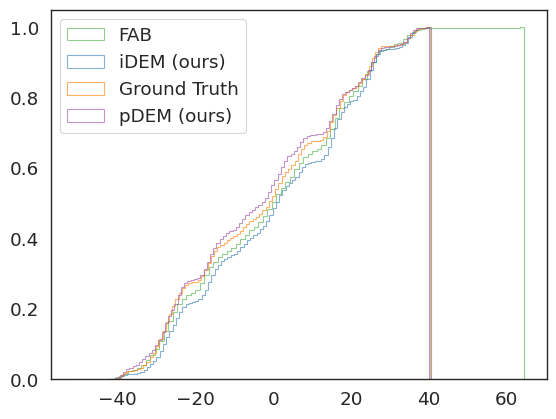

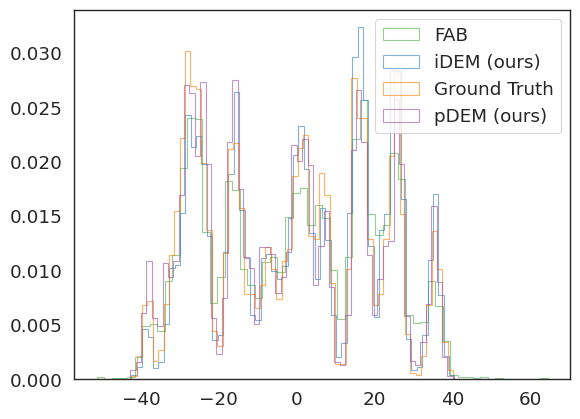

In [39]:
for key in ["FAB", "iDEM", "Test", "pDEM"]:
    plt.hist(samples[key][:,0].cpu().numpy(), bins=100, alpha=0.6, histtype="step",
             cumulative=True, density=True,
             label=labels[key], color=colors[key]);
plt.legend()

plt.show()

for key in ["FAB", "iDEM", "Test", "pDEM"]:
    plt.hist(samples[key][:,0].cpu().numpy(), bins=60, alpha=0.6, histtype="step",
             cumulative=False, density=True,
             label=labels[key], color=colors[key]);
plt.legend()

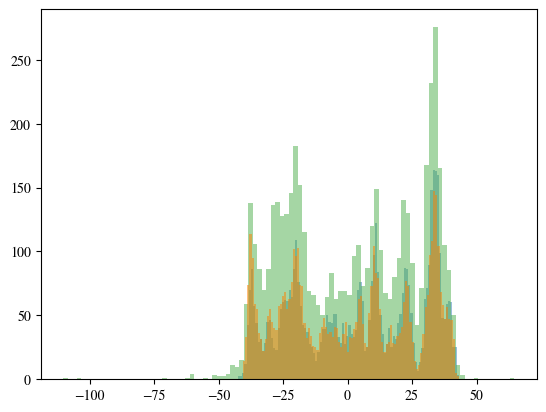

In [23]:
plt.hist(samples["iDEM"][:,1].cpu().numpy(), bins=100, alpha=0.5, label="iDEM", color=colors["iDEM"]);
plt.hist(samples["FAB"][:,1].cpu().numpy(), bins=100, alpha=0.5, label="FAB", color=colors["FAB"]);
plt.hist(samples["Test"][:,1].cpu().numpy(), bins=100, alpha=0.5, label=labels["Test"], color=colors["Test"]);

In [253]:
fig, axs = plt.subplots(1, 6, figsize=(36, 6), dpi=600)
for i, key in enumerate(samples.keys()):
    target.get_final_dataset_fig(samples[key], ax=axs[i], color=colors[key])
    axs[i].set_title(labels[key], fontsize=35)

plt.savefig('../../figures/' + data + '_samples.png',bbox_inches='tight')

## Equivariant Tasks

In [ ]:
data = "dw4"
filter = False
num_samples = 10000

if data == "lj13":
    dimensionality = 39
    from src.energies.lennardjones_energy import LennardJonesEnergy
    target = LennardJonesEnergy(
        dimensionality=dimensionality,
        n_particles=13,
        device=device,
        data_path = "../../data/test_split_LJ13-1000.npy",
        data_path_train =  "../../data/train_split_LJ13-1000.npy",
        data_path_val = "../../data/test_split_LJ13-1000.npy",
    )

if data == "dw4":
    dimensionality = 8
    from src.energies.multi_double_well_energy import MultiDoubleWellEnergy
    target = MultiDoubleWellEnergy(dimensionality,
                                   n_particles=4,
                                   data_path="../../data/test_split_DW4.npy",
                                   data_path_train="../../data/train_split_DW4.npy", 
                                   data_path_val="../../data/val_split_DW4.npy", 
                                   device=device)
    
if data == "lj55":
    dimensionality = 165
    from src.energies.lennardjones_energy import LennardJonesEnergy
    target = LennardJonesEnergy(
        dimensionality=dimensionality,
        n_particles=55,
        device=device,
        data_path = "../../data/test_split_LJ55-1000-part1.npy",
        data_path_train= "../../data/train_split_LJ55-1000-part1.npy",
        data_path_val = "../../data/val_split_LJ55-1000-part1.npy",
    )

In [ ]:
fab_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/fab_samples/" + data +'/'
fab_samples = read_all_files(fab_path).to(device).reshape(-1, dimensionality)
fab_samples = sample_from_tensor(fab_samples, num_samples)
fab_dists = target.interatomic_dist(fab_samples).detach().view(-1).cpu().numpy()

idem_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/idem_samples/" + data + '/'
# our_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/idem_samples/" + data + '/old/'
idem_samples = read_all_files(idem_path).to(device).reshape(-1, dimensionality)
idem_samples = sample_from_tensor(idem_samples, num_samples)
idem_dists = target.interatomic_dist(idem_samples).detach().view(-1).cpu().numpy()


dem_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/dem_samples/" + data + '/'
# our_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/idem_samples/" + data + '/old/'
dem_samples = read_all_files(dem_path).to(device).reshape(-1, dimensionality)
dem_samples = sample_from_tensor(dem_samples, num_samples)
dem_dists = target.interatomic_dist(dem_samples).detach().view(-1).cpu().numpy()


pis_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/pis_samples/" + data + '/'

pis_samples = read_all_files(pis_path).to(device).reshape(-1, dimensionality)
pis_samples = sample_from_tensor(pis_samples, num_samples)
pis_dists = target.interatomic_dist(pis_samples).detach().view(-1).cpu().numpy()

#dds_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/dds_samples_egnn/" + data + '/'
#dds_path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/dds_samples_mlp/" + data + '/'
dds_samples = torch.load("/network/scratch/a/alexander.tong/se3_diffusion/samples_step_500.pt").to(device).reshape(-1, dimensionality)
# dds_samples =  read_all_files(dds_path).to(device).reshape(-1, dimensionality)
dds_samples = sample_from_tensor(dds_samples, num_samples)
dds_dists = target.interatomic_dist(dds_samples).detach().view(-1).cpu().numpy()

test_samples = target.sample_test_set(num_samples)
test_dists = target.interatomic_dist(test_samples).detach().view(-1).cpu().numpy()


In [ ]:
fab_energy = target(fab_samples)
idem_energy = target(idem_samples)
dem_energy = target(dem_samples)
pis_energy = target(pis_samples)
dds_energy = target(dds_samples)
test_energy = target(test_samples)

In [ ]:
if filter:
    fab_energy = fab_energy[fab_energy>0]
    idem_energy = idem_energy[idem_energy>0]
    pis_energy = pis_energy[pis_energy>0]
    dds_energy = dds_energy[dds_energy>0]

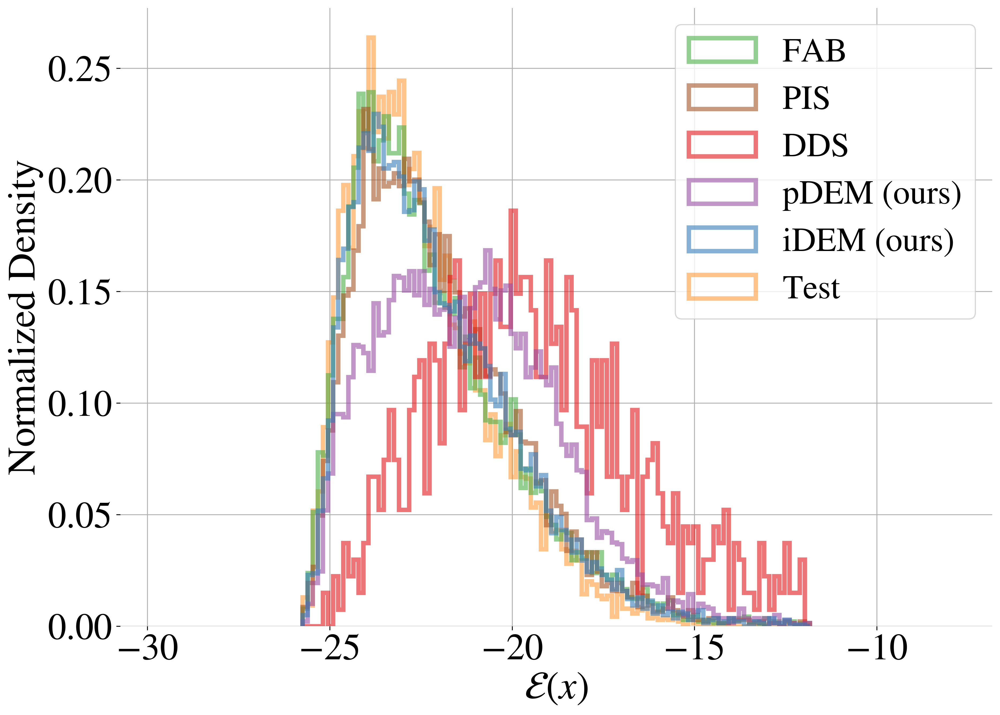

In [ ]:
fig, ax = plt.subplots(figsize = (14,10),dpi=300)
fig.patch.set_facecolor('white')

_, bins, _= plt.hist(
    -test_energy.detach().cpu(),
    bins=100,
    density=True,
    alpha=0.46,
    color=test_color,
    histtype='step',
    linewidth=4,
    label="Test"
);

if filter:
    bins = 200

plt.hist(-fab_energy.detach().cpu(),
         bins=bins,
         density=True,
         alpha=0.6,
         color=fab_color,
         histtype='step',
         linewidth=4,
         label="FAB"
);

plt.hist(-pis_energy.detach().cpu(),
         bins=bins,
         density=True,
         alpha=0.6,
         color=pis_color,
         histtype='step',
         linewidth=4,
         label="PIS"
);

plt.hist(-dds_energy.detach().cpu(),
         bins=bins,
         density=True,
         alpha=0.6,
         color=dds_color,
         histtype='step',
         linewidth=4,
         label="DDS"
);

plt.hist(-dem_energy.detach().cpu(),
         bins=bins,
         density=True,
         alpha=0.6,
         color=dem_color,
         histtype='step',
         linewidth=4,
         label="pDEM (ours)"
);

plt.hist(-idem_energy.detach().cpu(),
         bins=bins,
         density=True,
         alpha=0.6,
         color=idem_color,
         histtype='step',
         linewidth=4,
         label="iDEM (ours)"
);

plt.legend()

if not filter:
    lim_min = - (test_energy.max().item() + 5)
    lim_max = - (test_energy.min().item() - 5)
    plt.xlim(lim_min, lim_max)

plt.xticks(fontsize=33)
plt.yticks(fontsize=33)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.grid(True)
ax.xaxis.set_minor_locator(NullLocator())
ax.yaxis.set_minor_locator(NullLocator())
plt.xlabel(r"$\mathcal{E}(x)$",fontsize=35)
plt.ylabel("Normalized Density",fontsize=35)
plt.legend(fontsize=30)

# Retrieve the handles and labels
handles, labels = plt.gca().get_legend_handles_labels()
first_handle, first_label = handles.pop(0), labels.pop(0)
handles.append(first_handle)
labels.append(first_label)

# Create the new legend
plt.legend(handles, labels, fontsize=30)

plt.savefig('../../figures/' + data + '_energy.png',bbox_inches='tight')
plt.show()

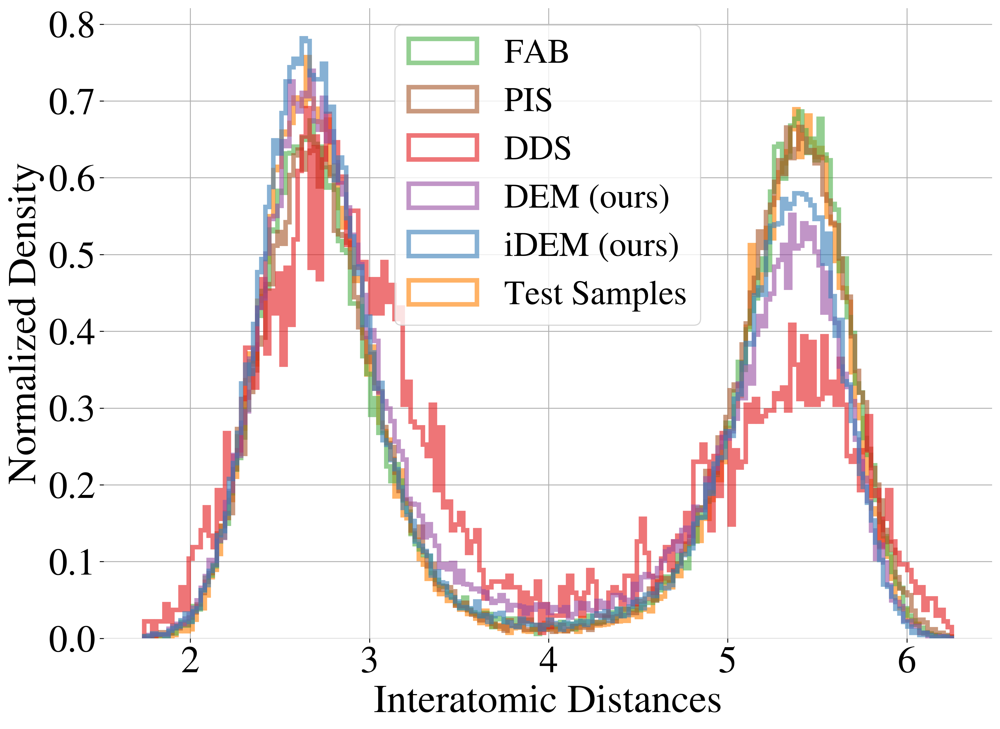

In [ ]:
fig, ax = plt.subplots(figsize = (14,10),dpi=300)
fig.patch.set_facecolor('white')

_, bins, _ = plt.hist(
    test_dists,
    bins=200,
    density=True,
    histtype="step",
    linewidth=4,
    alpha=0.6,
    label="Test Samples",
    color=test_color
);

plt.hist(
    fab_dists,
    bins=bins,
    density=True,
    histtype="step",
    linewidth=4,
    alpha=0.6,
    label="FAB",
    color=fab_color
)

plt.hist(
    pis_dists,
    bins=bins,
    density=True,
    histtype="step",
    linewidth=4,
    alpha=0.6,
    label="PIS",
    color=pis_color
)

plt.hist(
    dds_dists,
    bins=bins,
    density=True,
    histtype="step",
    linewidth=4,
    alpha=0.6,
    label="DDS",
    color=dds_color
)

plt.hist(
    dem_dists,
    bins=bins,
    density=True,
    histtype="step",
    linewidth=4,
    alpha=0.6,
    label="DEM (ours)",
    color=dem_color
)

plt.hist(
    idem_dists,
    bins=bins,
    density=True,
    histtype="step",
    linewidth=4,
    alpha=0.6,
    label="iDEM (ours)",
    color=idem_color
)

plt.xticks(fontsize=33)
plt.yticks(fontsize=33)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.grid(True)
ax.xaxis.set_minor_locator(NullLocator())
ax.yaxis.set_minor_locator(NullLocator())

plt.xlabel("Interatomic Distances",fontsize=35)
plt.ylabel("Normalized Density",fontsize=35)
plt.legend(fontsize=30)

# Retrieve the handles and labels
handles, labels = plt.gca().get_legend_handles_labels()
first_handle, first_label = handles.pop(0), labels.pop(0)
handles.append(first_handle)
labels.append(first_label)

# Create the new legend
plt.legend(handles, labels, fontsize=30)

plt.savefig('../../figures/' + data + '_interatomic_dists.png',bbox_inches='tight')
# plt.show()


## Diffusion Scales

In [ ]:
def read_all_files(folder, concat=True):
    samples = []
    files = os.listdir(folder)
    files = [f for f in files if f.endswith(".pt") or f.endswith(".npz") and not f.startswith(".")]
    files = [os.path.join(folder, f) for f in files]
    files = files[:4] + files[-1:-2]
    for f in files:
        if f.endswith(".pt"):
            samples.append(torch.load(f))
        if f.endswith(".npz"):
            samples.append(torch.tensor(np.load(f, allow_pickle=True)["samples"]))
    if concat:
        return torch.cat(samples, dim=0)
    else:
        return torch.stack(samples), files

In [ ]:
def extract_part(files):
    scales = []
    for file in files:
        # Splitting the string by underscores
        parts = file.split('_')

        # The desired part should be the second last element in the list
        ext = parts[-2]
        # ext = float(ext.lstrip('0')) / 100
        ext = int(ext.zfill(2)) / 100
        scales.append(ext)
    return scales

In [ ]:
path = "/network/scratch/a/alexander.tong/se3_diffusion/dem/idem_samples/lj55/serene_grass/" 
samples, files = read_all_files(path, concat=False)
samples = samples.to(device)
samples = sample_from_tensor(samples, num_samples)


test_samples = target.sample_test_set(num_samples)
test_energy = target(test_samples)
energy = torch.vmap(target)(samples)

In [ ]:
diff_scales = [0.05, 0.1, 0.2, 0.5]

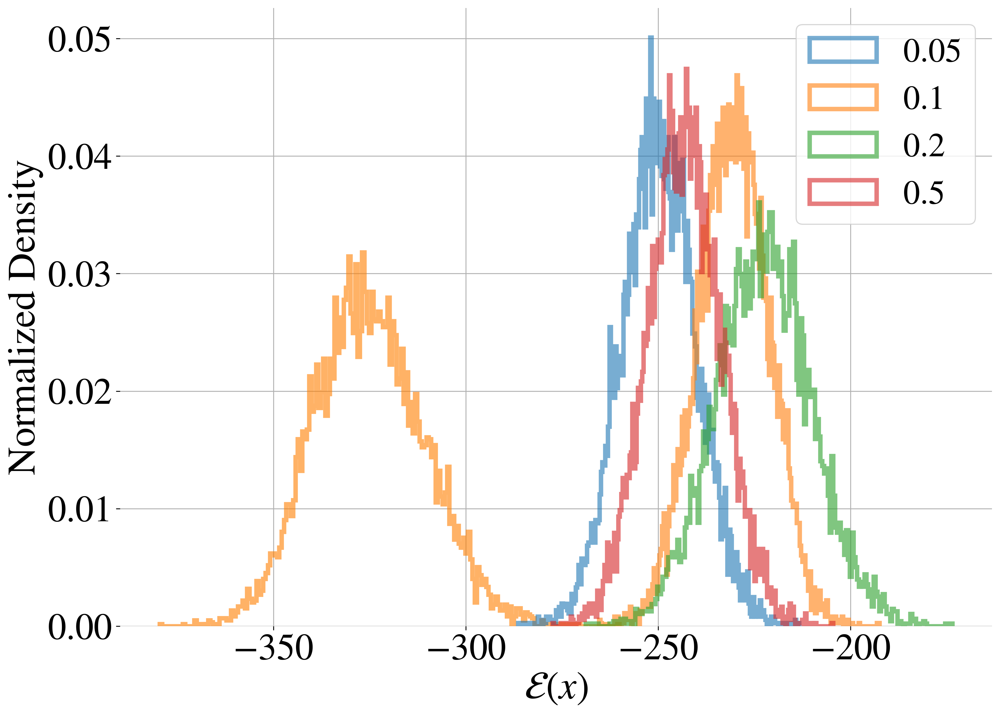

In [ ]:
fig, ax = plt.subplots(figsize = (14,10),dpi=300)
fig.patch.set_facecolor('white')
_, bins, _ = plt.hist(-test_energy.detach().cpu(),
        bins=200,
        density=True,
        alpha=0.6,
        color=test_color,
        histtype='step',
        linewidth=4,
);

for i in range(len(samples)):
        e_i = energy[i]
        e_i = e_i[e_i>0]
        plt.hist(-e_i.detach().cpu(),
                bins=200,
                density=True,
                alpha=0.6,
                histtype='step',
                linewidth=4,
                label = diff_scales[i]
        );

plt.xticks(fontsize=33)
plt.yticks(fontsize=33)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
plt.grid(True)
ax.xaxis.set_minor_locator(NullLocator())
ax.yaxis.set_minor_locator(NullLocator())

plt.xlabel(r"$\mathcal{E}(x)$",fontsize=35)
plt.ylabel("Normalized Density",fontsize=35)
plt.legend(fontsize=30)